# **GAN и котики**

В этой тетрадке мы рассмотрим работу WGAN.

Wasserstein GAN — это вариант архитектуры генеративно-состязательной сети (GAN), которая была создана для решения проблем нестабильности обучения, связанных с традиционными GAN. В особенности это касается решения проблемы вымывания или взрыва градиента.

В стандартном GAN генератор и дискриминатор обучаются с использованием двоичной функции перекрестных энтропийных потерь, которая измеряет разницу между прогнозируемым распределением вероятностей и истинным распределением. Однако это может привести к таким проблемам, как mode collapse и трудности в обучении.

WGAN представляет расстояние Вассерштайна (также известное как расстояние землекопа) как меру разницы между сгенерированными и реальными распределениями данных. Расстояние Вассерштайна обеспечивает более стабильную и значимую метрику для обучающихся GAN по сравнению с дивергенцией Дженсена-Шеннона или дивергенцией Кульбака-Лейблера, которые используются в традиционных GAN-ах.

Ключевым нововведением WGAN является использование критика вместо дискриминатора. Критик обучен выдавать оценку, которая показывает, насколько реалистичны созданные образцы. Процесс обучения предполагает минимизацию расстояния Вассерштайна между распределениями реальных и сгенерированных данных. Такой подход помогает смягчить mode collapse и стабилизировать тренировочный процесс.

## **WGAN GP**

GAN Вассерштайна с штрафом за градиент (WGAN-GP) — это расширение WGAN, которое помогает стабилизировать процесс обучения и устраняет некоторые ограничения исходной WGAN.

В стандартной WGAN расстояние Вассерштайна используется как функция потерь, а обучение включает оптимизацию параметров критика для минимизации разницы между распределением реальных и сгенерированных данных. Однако на практике соблюдение ограничения непрерывности Липшица для критика (необходимого для четкого определения расстояния Вассерштайна) может оказаться сложной задачей.

WGAN-GP решает эту проблему, вводя штраф за градиент, который наказывает норму градиента критика по отношению к его входным данным. Этот штраф побуждает критика вести себя мягко и помогает поддерживать липшицеву непрерывность без необходимости ограничения веса, которая использовалась в первоначальном WGAN и могла приводить к нестабильности тренировок.

Было показано, что WGAN-GP обеспечивает более стабильное обучение и генерацию выборок более высокого качества по сравнению с исходным WGAN, что делает его популярным выбором в области генеративных вычислений. Штраф градиента помогает обеспечить соблюдение ограничения непрерывности Липшица, не прибегая к потенциально проблематичным ограничениям весов сети.

## **Загрузка библитек и данных**

In [2]:
# Common imports
import os
import torch
import numpy as np
from tqdm import tqdm

# Dataset
from torchvision import transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid

# Data Visualization
import matplotlib.pyplot as plt

# Model
from torch import nn
from torch.nn import Module, Sequential
from torch.nn import Conv2d, ConvTranspose2d
from torch.nn import BatchNorm2d, ReLU, LeakyReLU, Tanh

# Metrics
# !pip install pytorch-msssim -qq
from pytorch_msssim import ssim

Укажем путь до данных и объявим все основные гиперпараметры.

In [26]:
DATA_DIR = '/kaggle/input/cats-64x64'

# ENV Constants
DEVICE = "cuda"
IMG_DIMS = 64
STATS = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

# Model Constants
ZDIM = 128
HDIM = 128
IMG_CHANNELS = 3

# Training Constants
LR = 2e-4
EPOCHS = 15
beta_1 = 0.5
C_LAMBDA = 10
beta_2 = 0.999
BATCH_SIZE = 16
CRITIC_STEPS = 5
DISPLAY_STEP = 500

# Reproducibility
np.random.seed(42)
torch.manual_seed(42)

Здесь же обернем данные в загрузчик и отрисуем экземпляры наших изображений.

In [27]:
data = ImageFolder(
    DATA_DIR, transform=transforms.Compose([
        transforms.Resize(IMG_DIMS),
        transforms.CenterCrop(IMG_DIMS),
        transforms.ToTensor(),
        transforms.Normalize(*STATS)
    ])
)

dataloader = DataLoader(
    data, BATCH_SIZE,
    shuffle=True, num_workers=os.cpu_count(),
    pin_memory=True
)

In [22]:
def denorm(img_tensors):
    """
    Обратное преобразование изображений в их исходный диапазон значений.
    """
    return img_tensors * STATS[1][0] + STATS[0][0]


def show_images(images, nmax=32):
    """
    Отображение изображений в виде сетки.
    """
    _, ax = plt.subplots(figsize=(12, 12))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))


def show_batch(dl, nmax=32):
    """
    Отображение пакета изображений.
    """
    for images, _ in dl:
        show_images(images, nmax)
        break

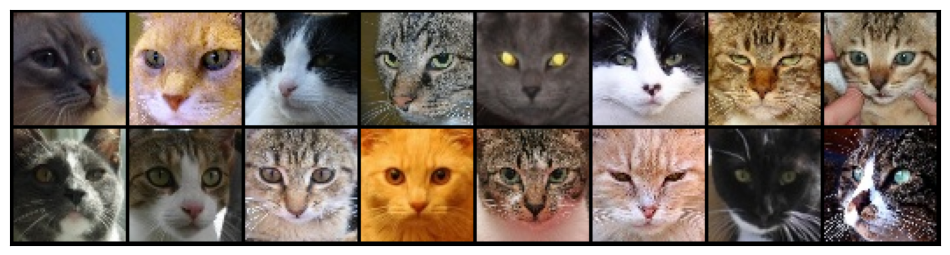

In [23]:
show_batch(dataloader)

## **Архитектура генератора**

Генератор в WGAN имеет стандартную архитектуру, начиная с входного вектора шума, который пропускатся через серию слоев сверточного транспонирования, постепенно повышая дискретизацию данных.

Пакетная нормализация и функции активации привносят нелинейность, помогая генерировать разнообразные и реалистичные функции. Последний уровень преобразует выходные данные, чтобы соответствовать желаемому диапазону данных.

Общая архитектура направлена ​​на эффективное сопоставление случайного шума с многомерным представлением, используя потери Вассерштайна для повышения стабильности обучения и создания разнообразных синтетических данных.

In [28]:
class Generator(Module):
    """
    Generator for a Spectral Normalization Generative Adversarial Network (SN GAN).

    Parameters:
    - zdims (int): Dimensionality of the input noise vector.
    - hdims (int): Dimensionality of the hidden layers in the generator.
    - img_channels (int): Number of channels in the output synthesized images.

    Attributes:
    - zdims (int): Dimensionality of the input noise vector.
    - generator (Sequential): Sequential model representing the generator architecture.
    """

    def __init__(self, zdims: int=ZDIM, hdims: int=HDIM, img_channels: int=IMG_CHANNELS):
        """
        Initializes the Generator.

        Args:
        - zdims (int): Dimensionality of the input noise vector.
        - hdims (int): Dimensionality of the hidden layers in the generator.
        - img_channels (int): Number of channels in the output synthesized images.
        """

        super(Generator, self).__init__()

        self.zdims = zdims
        self.generator = Sequential(
            self.generator_block(ZDIM, HDIM*4, kernel_size=4, stride=1, padding=0),
            self.generator_block(HDIM*4, HDIM*2, kernel_size=4, stride=2, padding=1),
            self.generator_block(HDIM*2, HDIM, kernel_size=4, stride=2, padding=1),
            self.generator_block(HDIM, HDIM // 2, kernel_size=4, stride=2, padding=1),
            self.generator_block(HDIM // 2, img_channels, kernel_size=4, stride=2, padding=1, output_layer=True)
        )

    def generator_block(
        self, input_dims: int, output_dims: int,
        kernel_size: int=3, stride: int=2,
        padding: int=0, bias=False,
        output_layer: bool=False):
        """
        Defines a generator block.

        Args:
        - input_dims (int): Dimensionality of the input to the block.
        - output_dims (int): Dimensionality of the output from the block.
        - kernel_size (int): Size of the convolutional kernel.
        - stride (int): Stride of the convolutional operation.
        - padding (int): Stride of the convolutional padding.
        - output_layer (bool): Indicates whether this block is the output layer.

        Returns:
        - Sequential: Generator block as a Sequential model.
        """

        if output_layer:
            return Sequential(
                ConvTranspose2d(input_dims, output_dims, kernel_size, stride, padding, bias=bias),
                Tanh()
            )
        else:
            return Sequential(
                ConvTranspose2d(input_dims, output_dims, kernel_size, stride, padding, bias=bias),
                BatchNorm2d(output_dims),
                ReLU(inplace=True)
            )

    def forward(self, noise):
        """
        Forward pass of the generator.

        Args:
        - noise (Tensor): Input noise tensor.

        Returns:
        - Tensor: Synthesized images.
        """
        synthesized_images = self.generator(noise)
        return synthesized_images


В области генеративно-состязательных сетей (GAN) суть генераторов заключается в способности преобразовывать вектор шума в вектор изображения. Чтобы отправиться в этот путь творческого синтеза, нам предстоит создать сам вектора шума.

In [29]:
def generate_noise(n_samples: int, z_dims: int=ZDIM, device: str=DEVICE) -> torch.Tensor:
    """
    Generate a random noise vector for GAN input.

    Args:
    - n_samples (int): Number of noise vectors to generate.
    - z_dims (int): Dimensionality of the noise vector.
    - device (str): Device to place the generated noise tensor (default is DEVICE).

    Returns:
    - torch.Tensor: Random noise vector of shape (n_samples, z_dims).
    """
    return torch.randn(n_samples, z_dims, 1, 1, device=device)

In [26]:
noise = generate_noise(4, device="cpu")
noise.shape

torch.Size([4, 128, 1, 1])

Создадим функцию для визуализации векторов шума. Этот универсальный инструмент не ограничивается шумом — он легко адаптируется к любому входному изображению или сгенерированному контенту.

Эта функция станет нашим визуальным руководством во время путешествия по генерируемому ландшафту GAN, проливая свет на процесс обучения, демонстрируя развивающиеся творения генератора и, в конечном итоге, помогая во всесторонней оценке результатов, сгенерированных моделью.

In [32]:
def show_generations(synthesized_images, rows_cols=None, figsize=None, title=None, save_loc=None):
    """
    Display a grid of synthetic images generated by the generator.

    Args:
        generations (torch.Tensor): A tensor containing synthetic image data.
        rows_cols (tuple): Number of rows and columns in the grid.
        figsize (tuple): Size of the figure (default is (8, 5)).
        title (str): Title for the figure (default is None).
        save_loc (str): File path to save the figure (default is None).

    """
    synthesized_images = denorm(synthesized_images)
    if rows_cols is not None:
        I, J = rows_cols
    else:
        I, J = abs(-synthesized_images.shape[0] // 4), 4
    # Визуализируем результат
    if figsize is not None:
        _, axs = plt.subplots(I, J, figsize=figsize)
    else:
        _, axs = plt.subplots(I, J, figsize=(12, 6 * noise.shape[0] // 6))
    plt.suptitle("Synthetic Images" if title is None else title)
    for i in range(I):
        for j in range(J):
            index = i * J + j
            if index < synthesized_images.shape[0]:
                if I == 1:
                    axs[j].imshow(synthesized_images[index].detach().cpu().numpy().transpose(1, 2, 0))
                    axs[j].axis('off')
                else:
                    axs[i, j].imshow(synthesized_images[index].detach().cpu().numpy().transpose(1, 2, 0))
                    axs[i, j].axis('off')
    
    if save_loc is not None:
        if not os.path.exists(os.path.dirname(save_loc)):
            os.makedirs(os.path.dirname(save_loc))
        plt.savefig(save_loc)

    plt.show()

Посмотрим на результаты обработки случайного шума необученным генератором.

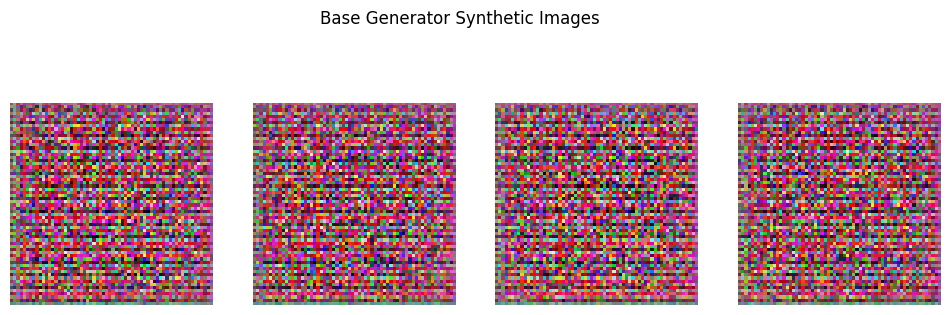

In [27]:
synthetic_images = Generator()(noise)

show_generations(
    synthetic_images,
    title="Base Generator Synthetic Images",
    save_loc = "./GeneratorImages/base_generations.png"
)

Мы видим именно то, что и ожидалось: просто шум.

## **Архитектура критика**

Архитектура критика в GAN служит противником генератора, играя решающую роль в различении реальных и сгенерированных данных. Обычно реализуемый как сборку из CNN-слоев, критик принимает входные данные в виде выборок и стремится присвоить изображению оценку, описывающую, насколько оно реалистично.

In [13]:
class Critic(Module):
    def __init__(self, hdims: int=HDIM, img_channels: int=IMG_CHANNELS):
        """
        Initialize the Critic network.

        Args:
        - img_channels (int): Number of input channels (e.g., 1 for grayscale, 3 for RGB).
        - hdims (int): Number of channels in the first hidden layer.
        """
        super(Critic, self).__init__()

        self.critic = Sequential(
            self.critic_block(img_channels, hdims // 2),
            self.critic_block(hdims // 2, hdims),
            self.critic_block(hdims, hdims*2),
            self.critic_block(hdims*2, hdims*4),
            self.critic_block(hdims*4, 1, padding=0, output_layer=True),
        )

    def critic_block(self, input_dims, output_dims, kernel_size=4, stride=2, padding=1, bias=False, output_layer=False):
        """
        Create a Critic block.

        Args:
        - input_dims (int): Number of input channels.
        - output_dims (int): Number of output channels.
        - kernel_size (int): Size of the convolutional kernel.
        - stride (int): Stride for the convolution operation.
        - output_layer (bool, optional): If True, only spectral normalization is applied, else batch normalization and LeakyReLU are added.

        Returns:
        - Sequential: A Critic block.
        """
        if output_layer:
            return Sequential(
                Conv2d(input_dims, output_dims, kernel_size, stride, padding, bias=bias)
            )
        else:
            return Sequential(
                Conv2d(input_dims, output_dims, kernel_size, stride, padding, bias=bias),
                BatchNorm2d(output_dims),
                LeakyReLU(0.2, inplace=True)
            )

    def forward(self, image):
        """
        Forward pass of the Critic network.

        Args:
        - image (torch.Tensor): The input image.

        Returns:
        - torch.Tensor: The Critic's prediction.
        """
        critic_pred = self.critic(image)
        return critic_pred


## **Сборка WGAN**

Строительные блоки GAN готовы. Теперь пришло время объединить эти строительные блоки, чтобы составить окончательную архитектуру.

In [41]:
# Initialize the generator
generator = Generator().to(DEVICE)

# Initialize generator optimizer
generator_optim = torch.optim.Adam(params = generator.parameters(), lr = LR, betas = (beta_1, beta_2))

# Initialize the critic
critic = Critic().to(DEVICE)

# Initialize critic optimizer
critic_optim = torch.optim.Adam(params = critic.parameters(), lr = LR, betas = (beta_1, beta_2))

In [15]:
# Normalize the weights of generator and critic
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

generator = generator.apply(weights_init)
critic = critic.apply(weights_init)

## **Штраф градиента**

Процесс вычисления штрафа включает в себя создание смешанного изображения путем объединения реального и поддельного изображений, получение вывода критика по этому смешанному изображению и последующее вычисление градиента вывода критика относительно пикселей смешанного изображения.

Этот градиент затем используется для расчета штрафного члена путем измерения квадрата нормы градиента минус 1, масштабируемого с помощью гиперпараметра лямбда. Цель этого градиентного штрафа — обеспечение непрерывности Липшица в критике, гарантируя более плавный процесс обучения и смягчение проблемы нестабильности обучения.

Коротко говоря, полученный штраф включается в функцию потерь WGAN-GP для повышения стабильности и эффективности генеративно-состязательной сети во время обучения.

In [16]:
def extract_gradients(critic: Module, real: torch.Tensor, fake: torch.Tensor, epsilon: torch.Tensor) -> torch.Tensor:
    """
    Extracts the gradients of the critic's output with respect to the pixels of mixed images.

    Parameters:
        critic (torch.nn.Module): The critic model.
        real (torch.Tensor): Real images.
        fake (torch.Tensor): Fake images.
        epsilon (float): Weighting factor for combining real and fake images in creating mixed images.

    Returns:
        torch.Tensor: Gradients of the critic's output with respect to the pixels of the mixed images.
    """
    # Create mixed images
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Get critic's scores on the mixed images
    mixed_scores = critic(mixed_images)

    # Compute gradients
    gradients = torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True
    )[0]

    return gradients


Теперь нам нужна другая функция, которая будет принимать эти градиенты и вычислять на их основе штраф.

In [17]:
def gradient_penalty(gradients: torch.Tensor) -> torch.Tensor:
    """
    Computes the gradient penalty based on the norm of the gradients.

    Parameters:
        gradients (torch.Tensor): Gradients of the critic's output with respect to the pixels.

    Returns:
        torch.Tensor: Computed gradient penalty.
    """
    # Reshape gradients for computation
    gradients = gradients.view(len(gradients), -1)

    # Calculate the L2 norm of gradients
    gradient_norm = gradients.norm(2, dim=1)

    # Compute the penalty term
    penalty = torch.mean((gradient_norm - 1) ** 2)

    return penalty

## **Loss-ы**

Потери генератора и критика, используемые в WGAN-GP, предназначены для решения конкретных задач, связанных с обучением GAN. Небесполезно рассмотреть интуицию каждой из них:

1. **Потери генератора:**
 - **Цель:** Потеря генератора направлена ​​на то, чтобы побудить генератор производить образцы, которые, по мнению критика, неотличимы от реальных образцов.
 - **Интуиция.** Минимизируя отрицательное среднее значение результатов критика для сгенерированных образцов, генератор получает стимул создавать образцы, которые критику нелегко отличить от реальных. Это соответствует цели WGAN по достижению значимого расстояния Вассерштайна между реальными и сгенерированными распределениями данных. В отличие от традиционных GAN, WGAN обеспечивают более стабильный обучающий сигнал для генератора.

2. **Потери критика:**
 - **Цель:** Потери критика состоят из двух основных компонентов: поощрение критика оценивать поддельные образцы ниже, чем реальные образцы, и включение градиентного штрафа для обеспечения непрерывности Липшица.
 - **Интуиция:**
    * Первый термин (torch.mean(crit_fake_pred) - torch.mean(crit_real_pred)) гарантирует, что критик различает настоящие и поддельные образцы. Генератор минимизирует этот термин, создавая реалистичные образцы, а критик максимизирует его для улучшения дискриминации.
    * Второй член (c_lambda x gp) вводит штраф за градиент (gp) для обеспечения непрерывности Липшица, что помогает стабилизировать обучение. Штраф пропорционален отклонению нормы градиента от 1. Добавляя этот термин, WGAN-GP призывает критика иметь константу Липшица, равную 1, что снижает риск коллапса и улучшает сходимость процесса обучения.

Таким образом, потери генератора подталкивают генератор к созданию реалистичных образцов, в то время как потери критика помогают сети эффективно различать реальные и сгенерированные образцы и поддерживать липшицеву непрерывность за счет штрафа за градиент. Эта комбинация помогает решить такие проблемы, как коллапс и нестабильность обучения, что приводит к более стабильному и надежному обучению GAN.

In [18]:
# Updated generator Loss
def compute_generator_loss(critic_fake_pred):
    """
    Calculates the generator loss for a Wasserstein GAN.

    Parameters:
        critic_fake_pred (torch.Tensor): Critic's output for fake/generated samples.

    Returns:
        torch.Tensor: Generator loss.
    """
    return -1. * torch.mean(critic_fake_pred)

# Updated Critic Loss
def compute_critic_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    """
    Calculates the critic loss for a Wasserstein GAN with Gradient Penalty.

    Parameters:
        crit_fake_pred (torch.Tensor): Critic's output for fake/generated samples.
        crit_real_pred (torch.Tensor): Critic's output for real samples.
        gp (torch.Tensor): Gradient penalty.
        c_lambda (float): Hyperparameter controlling the strength of the gradient penalty.

    Returns:
        torch.Tensor: Critic loss.
    """
    return torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp

**Интуиция потерь генератора:**
 * Когда генератор создает фейковые изображения, критик легко идентифицирует их как фейковые, присваивая крайне отрицательные значения. В ответ генератор корректирует свои параметры, чтобы уменьшить эти потери, создавая более убедительные и реалистичные изображения.

**Интуиция критика потерь:**
 * Критик генерирует прогнозы для реальных и поддельных изображений, с которыми сталкивается. Если эти прогнозы для поддельных изображений неточны и присваивают положительные значения, а прогнозы для реальных изображений отрицательны, то рстут общие потери. Это мотивирует критика улучшить свои возможности классификации за счет минимизации потерь, что соответствует цели точного различения реальных и поддельных образцов.

## **Метрика SSIM**

SSIM (Structural Similarity Index Metric) — это метрика, используемая для оценки качества изображений. Она была разработана для измерения сходства между двумя изображениями и является более точной и воспринимаемой человеком альтернативой традиционным метрикам, таким как PSNR (Peak Signal-to-Noise Ratio) и MSE (Mean Squared Error).

### Основные аспекты SSIM:

1. **Структурное сходство**: SSIM оценивает структурное сходство между двумя изображениями, учитывая изменения в освещении, контрасте и структуре. Это делает её более чувствительной к изменениям, которые важны для человеческого восприятия.

2. **Компоненты SSIM**:
- **Яркость (Luminance)**: Оценивает разницу в средней яркости между двумя изображениями.
- **Контраст (Contrast)**: Оценивает разницу в контрасте между двумя изображениями.
- **Структура (Structure)**: Оценивает сходство в структуре между двумя изображениями.

3. **Формула SSIM**:
SSIM индекс (SSIM) рассчитывается как комбинация трёх компонентов: яркости, контраста и структуры. Формула выглядит следующим образом: $$\text{SSIM}(x, y) = [l(x, y)]^\alpha \cdot [c(x, y)]^\beta \cdot [s(x, y)]^\gamma$$ где $l(x, y)$, $c(x, y)$ и $s(x, y)$ — это функции яркости, контраста и структуры соответственно, а $\alpha$, $\beta$ и $\gamma$ — параметры, которые обычно принимают значение 1.

### Применение SSIM:

1. **Оценка качества изображений**: SSIM используется для оценки качества сжатых или обработанных изображений по сравнению с оригинальными изображениями. Это полезно в задачах сжатия изображений, восстановления изображений и других областях обработки изображений.

2. **Сравнение изображений**: SSIM позволяет количественно оценить, насколько два изображения похожи друг на друга, что полезно в задачах распознавания образов и компьютерного зрения.

3. **Оптимизация алгоритмов**: SSIM может использоваться для оптимизации алгоритмов обработки изображений, чтобы минимизировать потерю качества, воспринимаемую человеком.

## **Обучение WGAN**

Теперь у нас есть все необходимые компоненты для обучения WGAN с градиентным штрафом.

  0%|          | 0/985 [00:00<?, ?it/s]

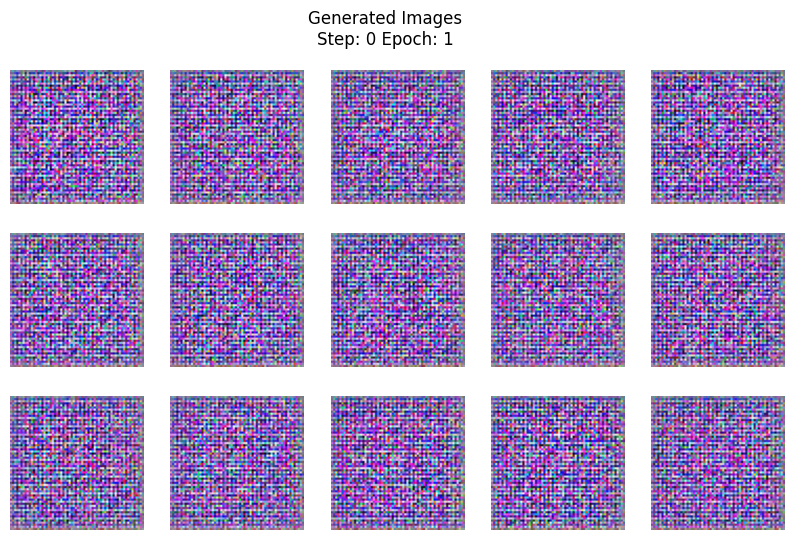

 51%|█████     | 500/985 [01:20<01:17,  6.29it/s]

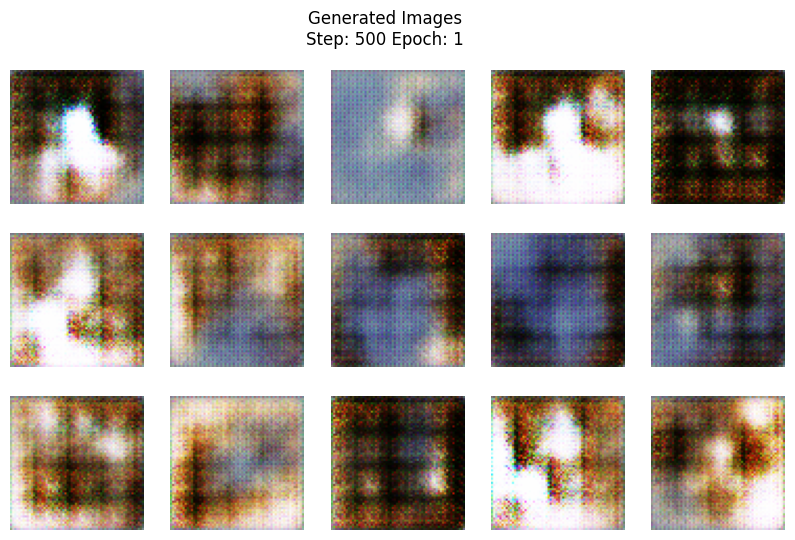

100%|██████████| 985/985 [02:38<00:00,  6.20it/s]


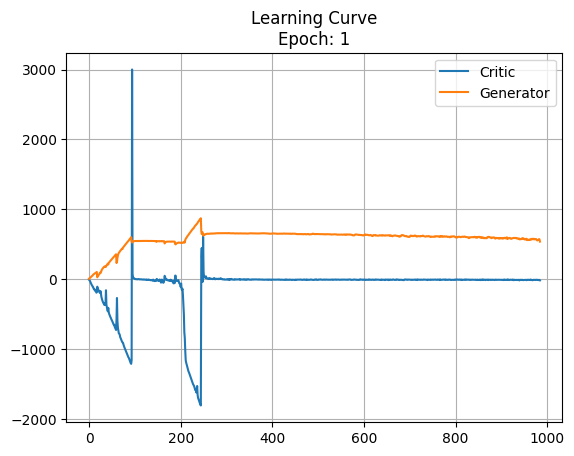

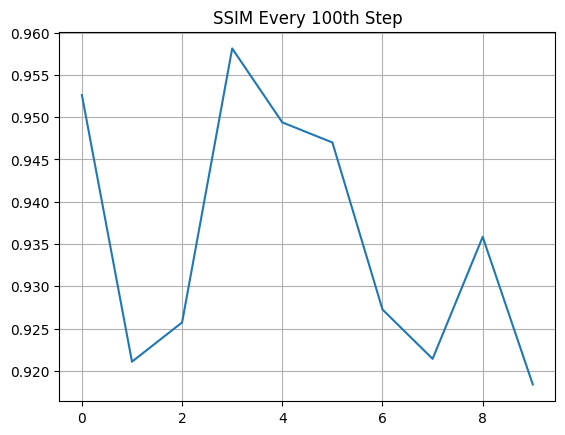

  0%|          | 0/985 [00:00<?, ?it/s]

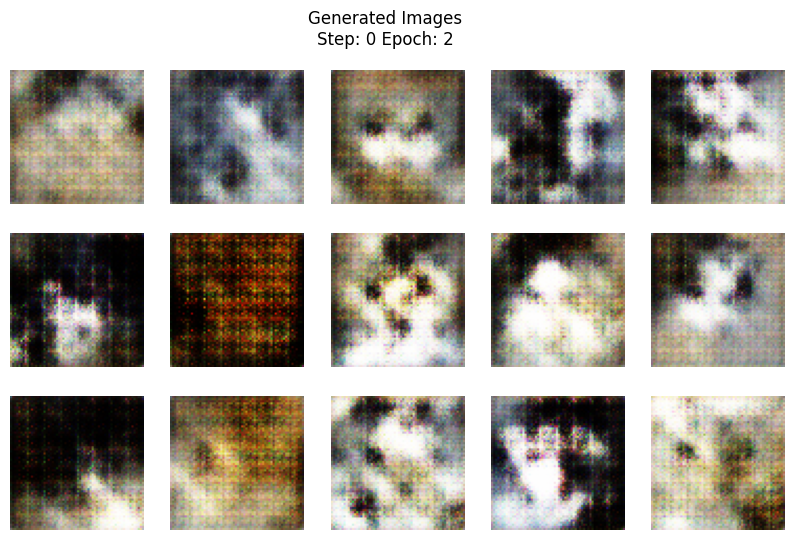

 51%|█████     | 500/985 [01:20<01:17,  6.29it/s]

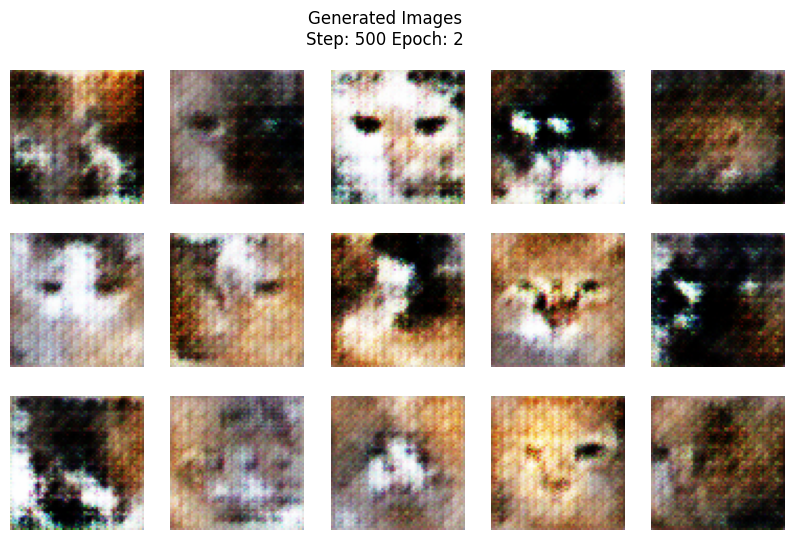

100%|██████████| 985/985 [02:38<00:00,  6.21it/s]


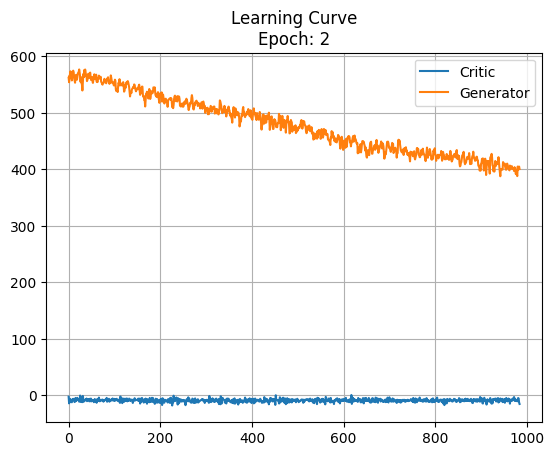

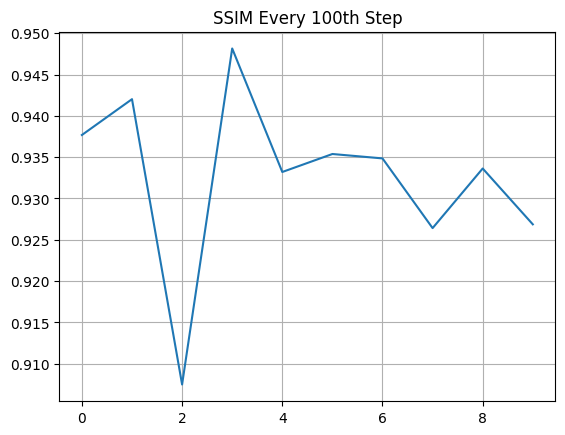

  0%|          | 0/985 [00:00<?, ?it/s]

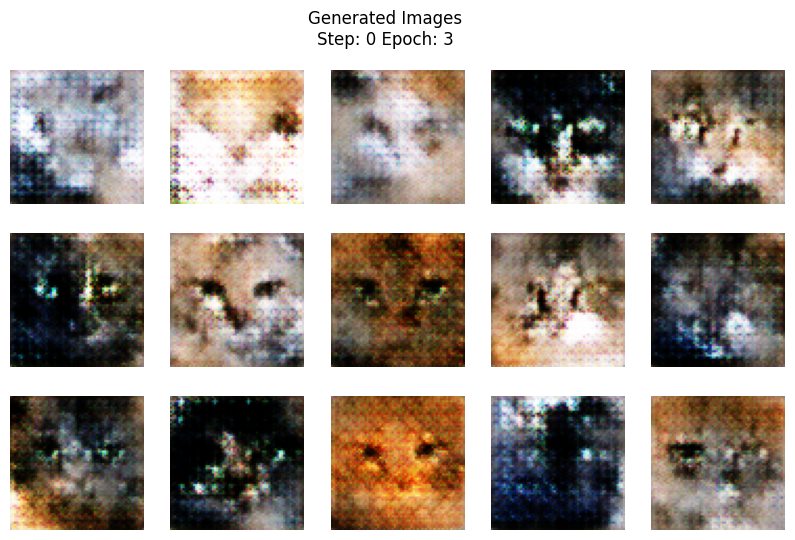

 51%|█████     | 500/985 [01:20<01:17,  6.29it/s]

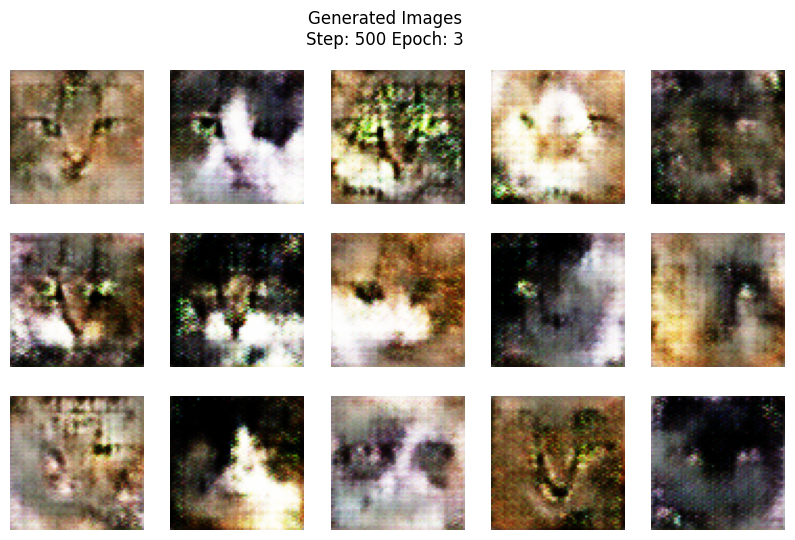

100%|██████████| 985/985 [02:39<00:00,  6.19it/s]


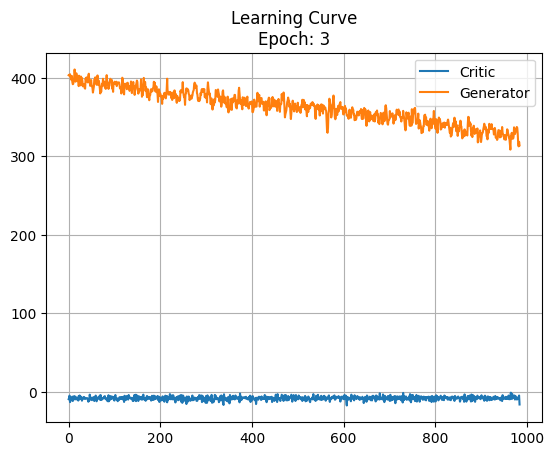

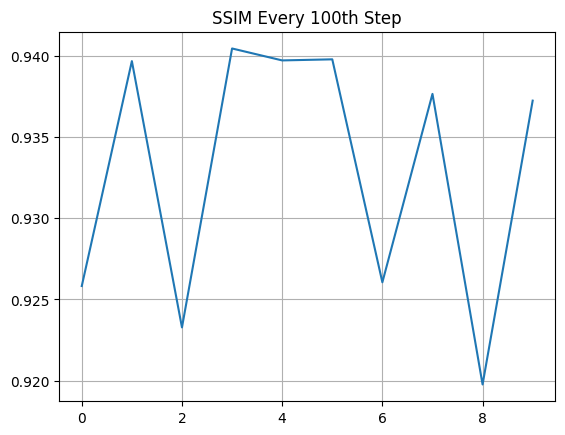

  0%|          | 0/985 [00:00<?, ?it/s]

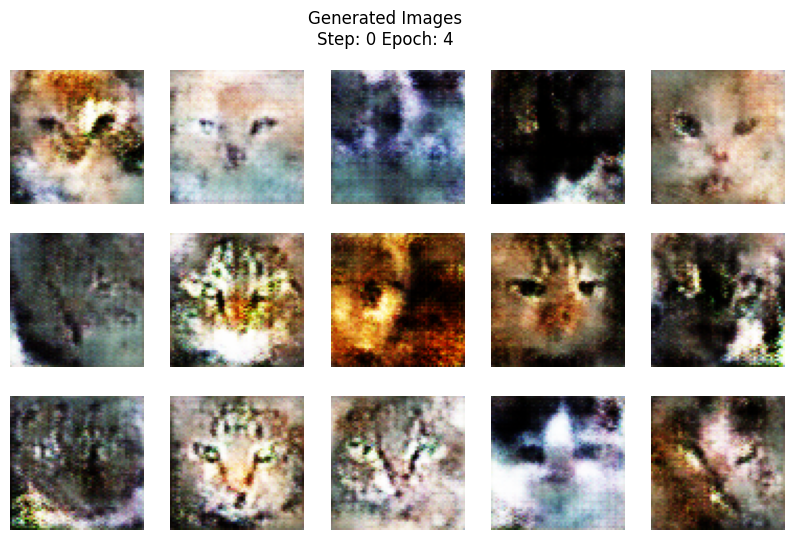

 51%|█████     | 500/985 [01:20<01:17,  6.28it/s]

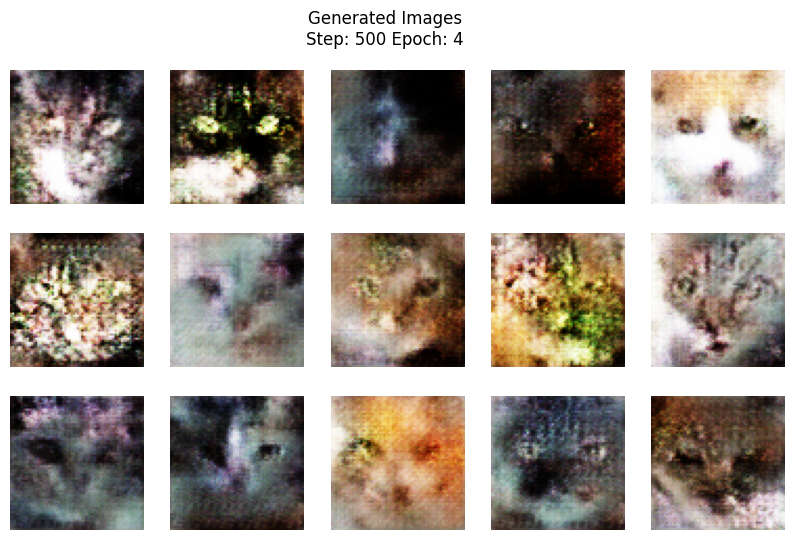

100%|██████████| 985/985 [02:39<00:00,  6.19it/s]


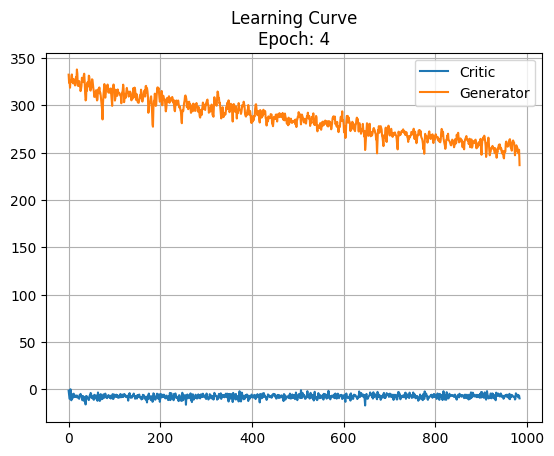

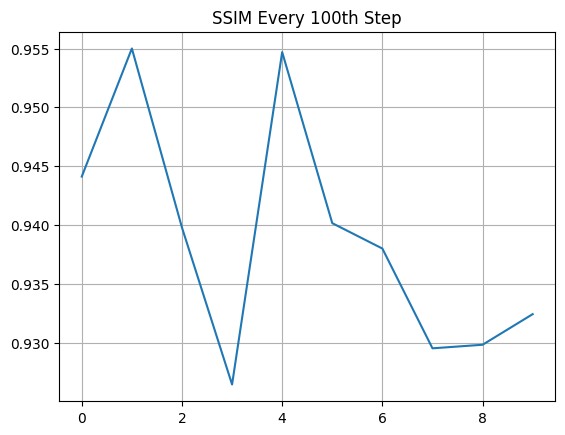

  0%|          | 0/985 [00:00<?, ?it/s]

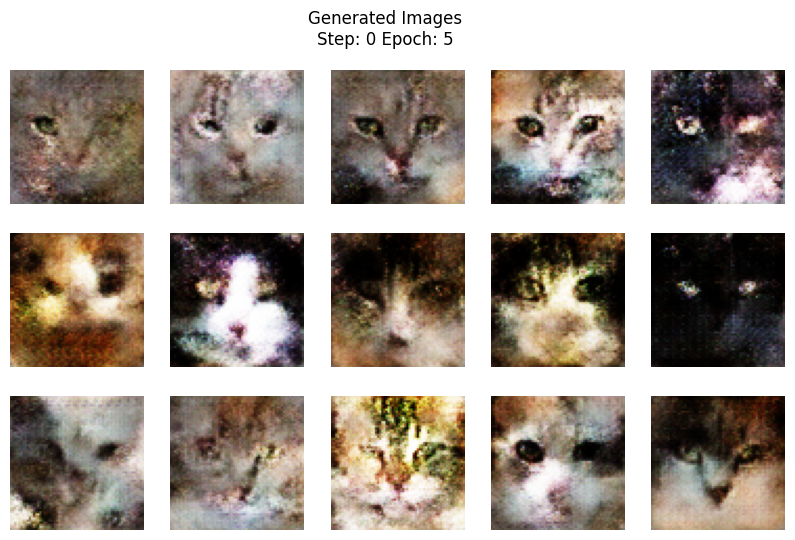

 51%|█████     | 500/985 [01:21<01:17,  6.28it/s]

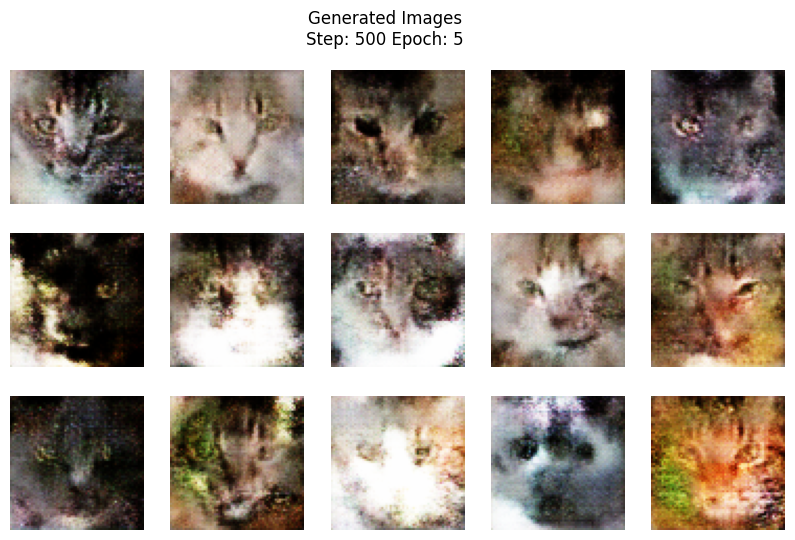

100%|██████████| 985/985 [02:39<00:00,  6.19it/s]


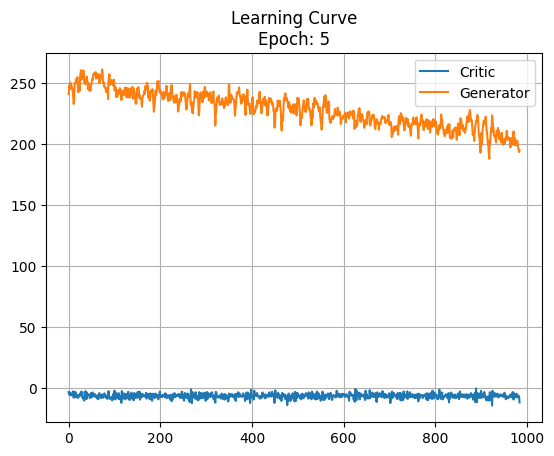

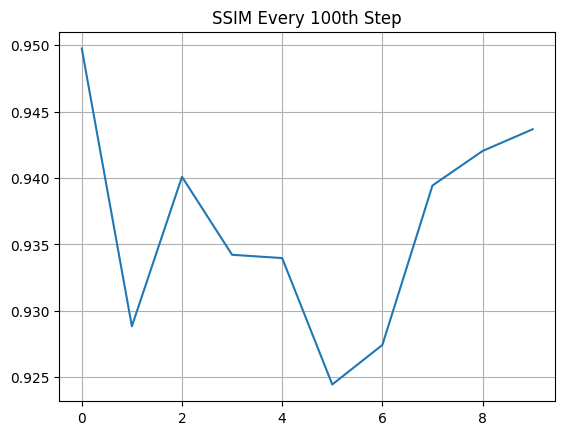

  0%|          | 0/985 [00:00<?, ?it/s]

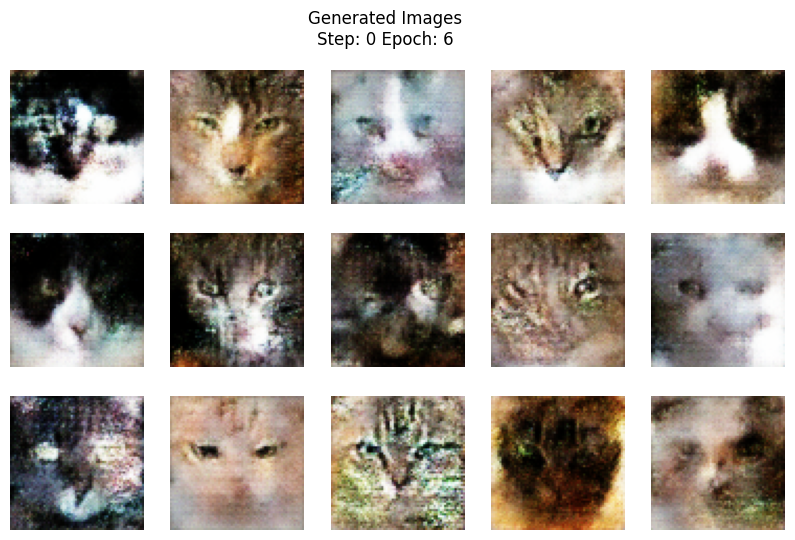

 51%|█████     | 500/985 [01:20<01:17,  6.26it/s]

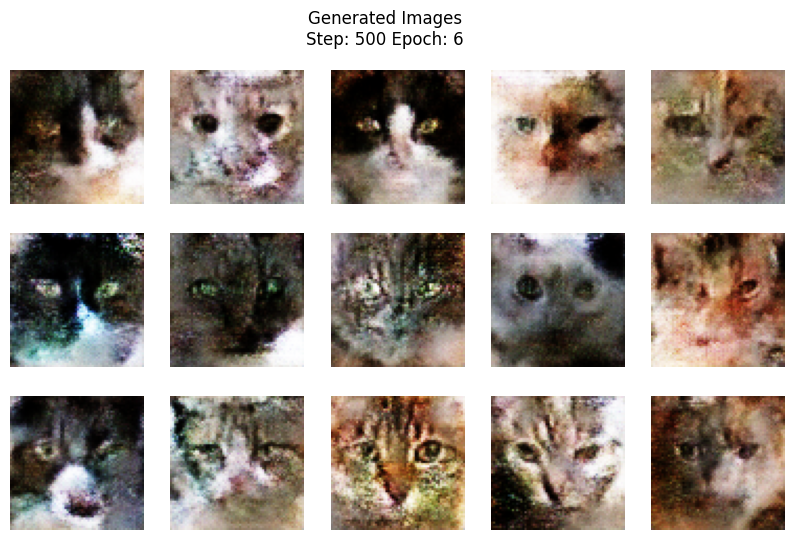

100%|██████████| 985/985 [02:38<00:00,  6.21it/s]


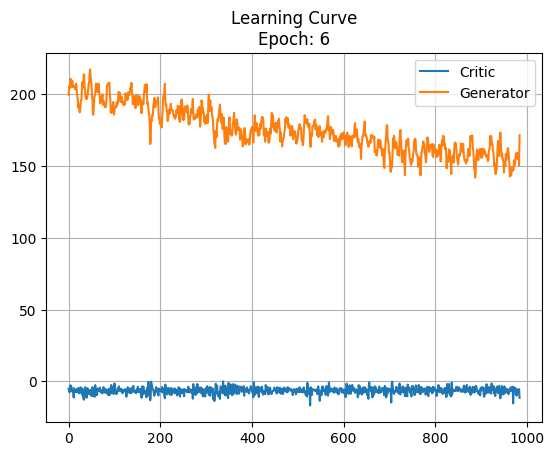

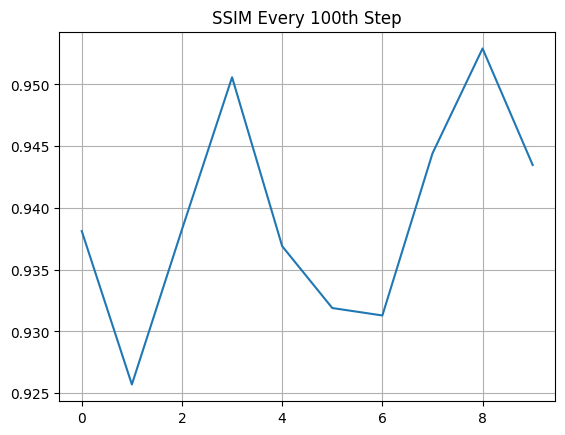

  0%|          | 0/985 [00:00<?, ?it/s]

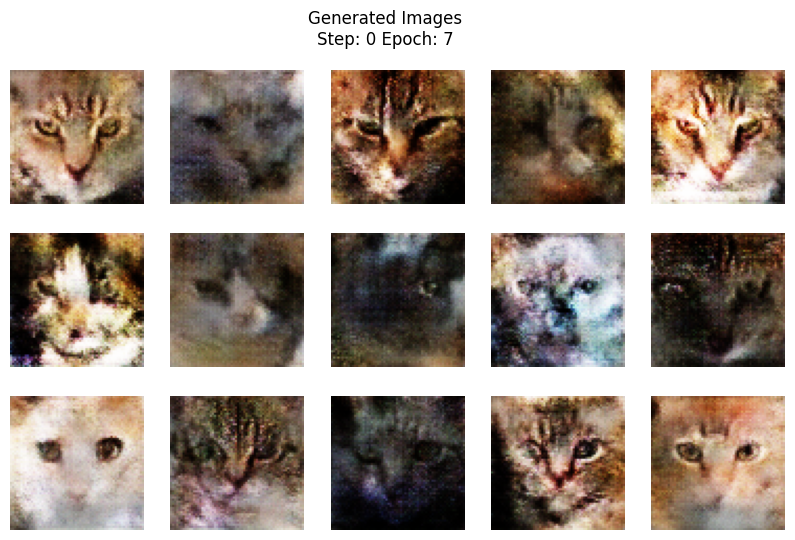

 51%|█████     | 500/985 [01:20<01:17,  6.23it/s]

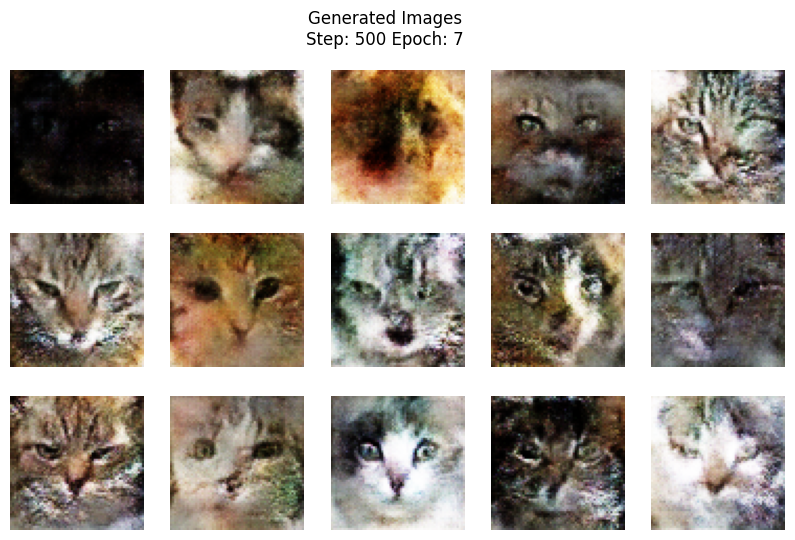

100%|██████████| 985/985 [02:38<00:00,  6.20it/s]


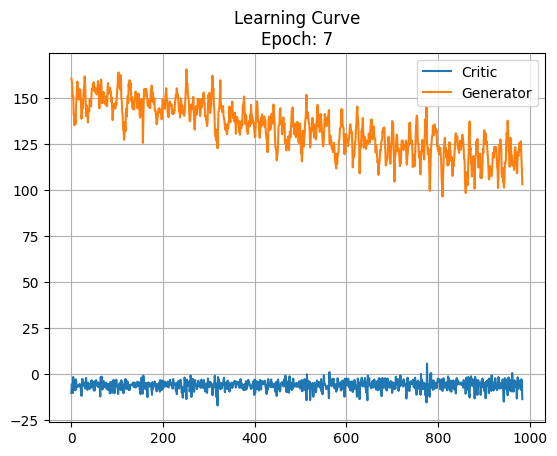

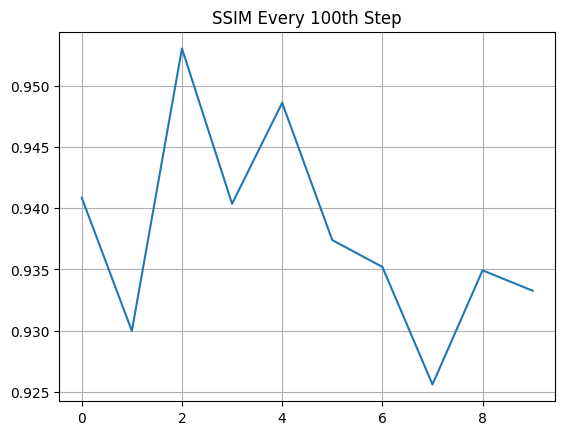

  0%|          | 0/985 [00:00<?, ?it/s]

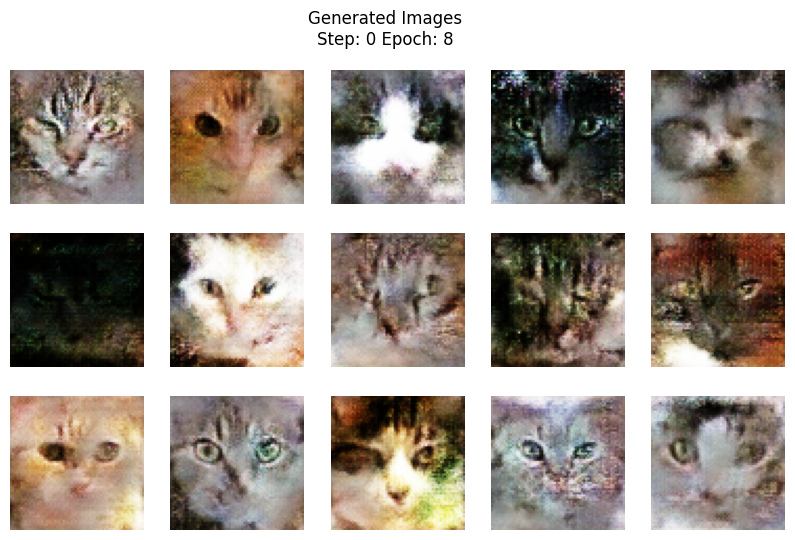

 51%|█████     | 500/985 [01:20<01:17,  6.29it/s]

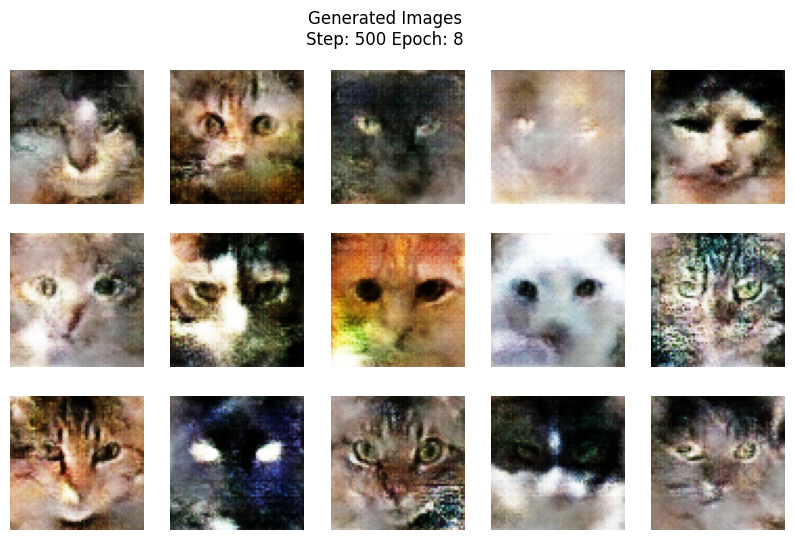

100%|██████████| 985/985 [02:39<00:00,  6.19it/s]


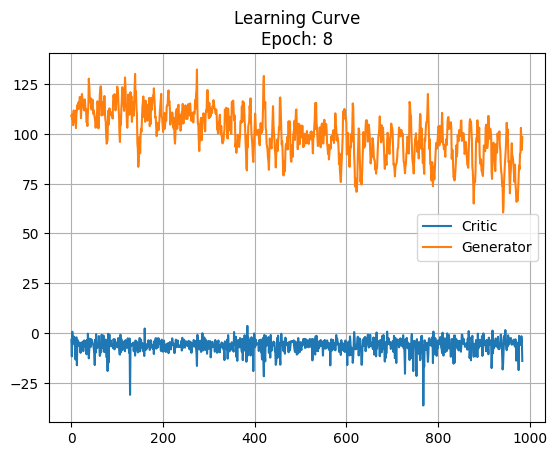

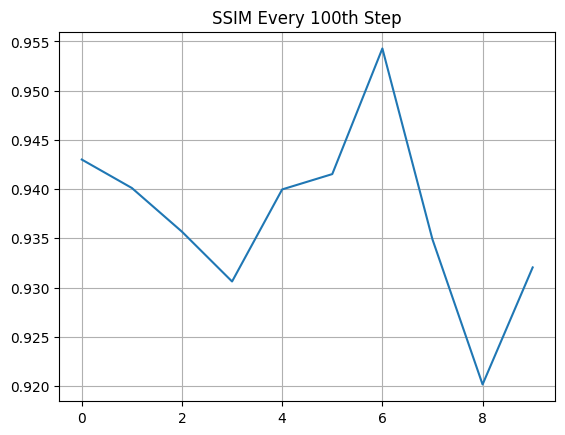

  0%|          | 0/985 [00:00<?, ?it/s]

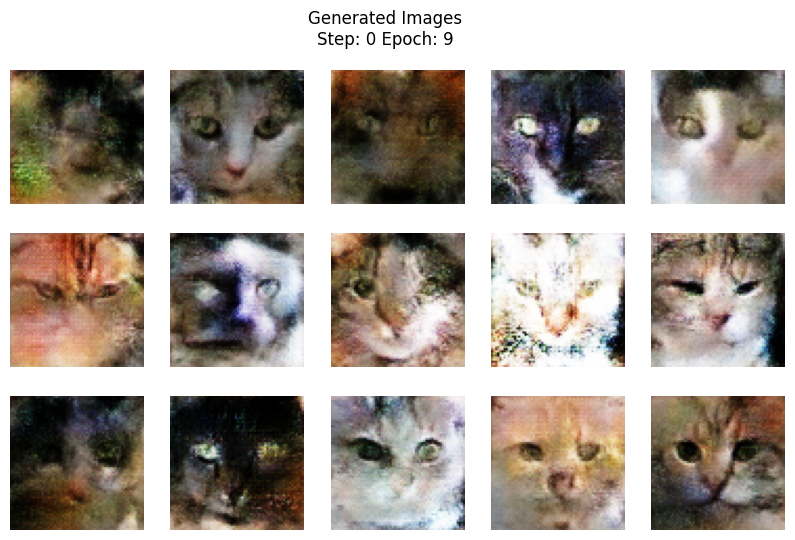

 51%|█████     | 500/985 [01:20<01:17,  6.29it/s]

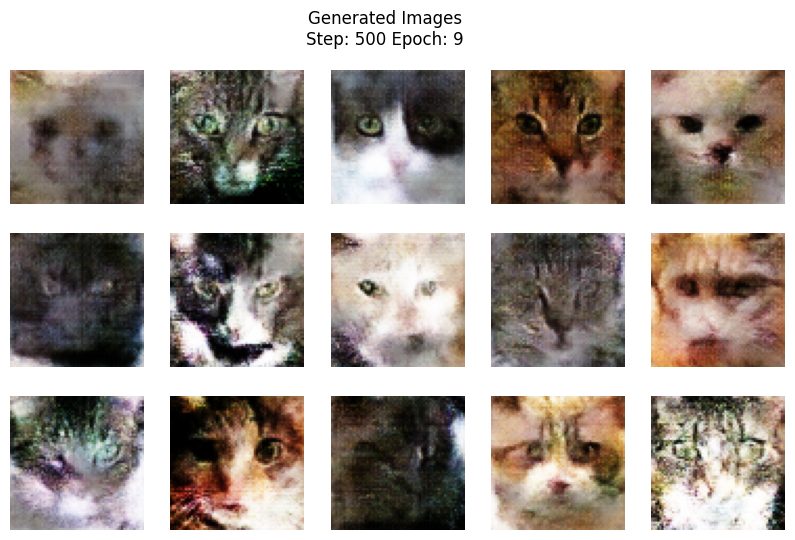

100%|██████████| 985/985 [02:38<00:00,  6.20it/s]


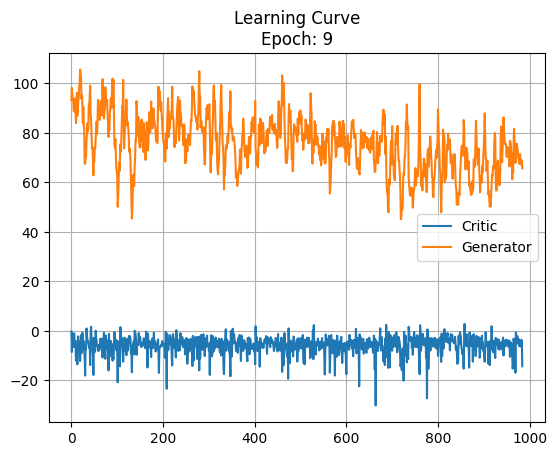

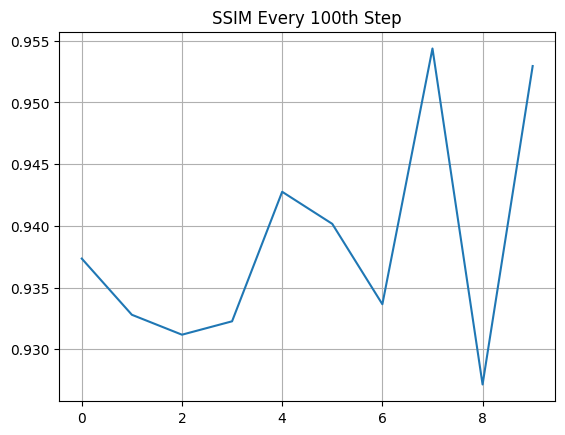

  0%|          | 0/985 [00:00<?, ?it/s]

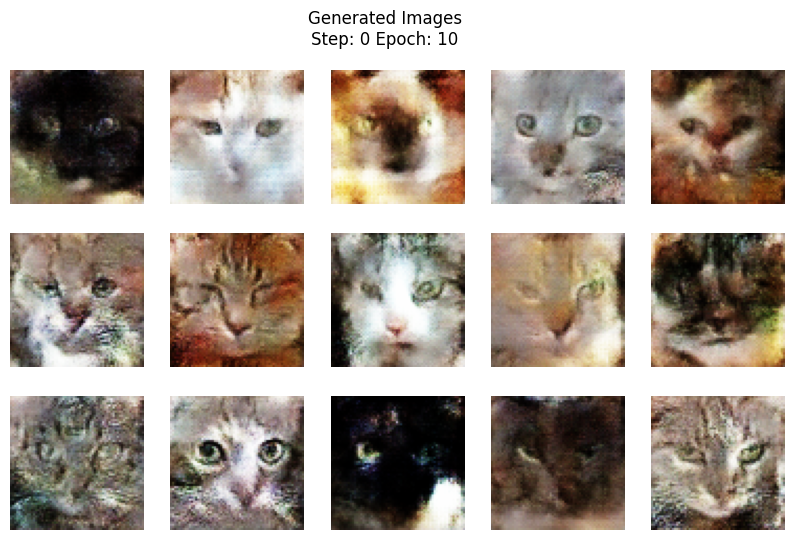

 51%|█████     | 500/985 [01:21<01:17,  6.29it/s]

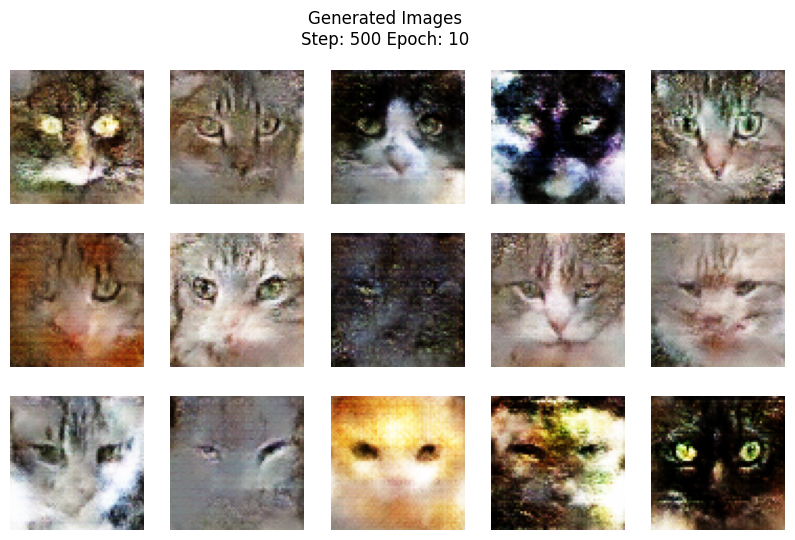

100%|██████████| 985/985 [02:39<00:00,  6.19it/s]


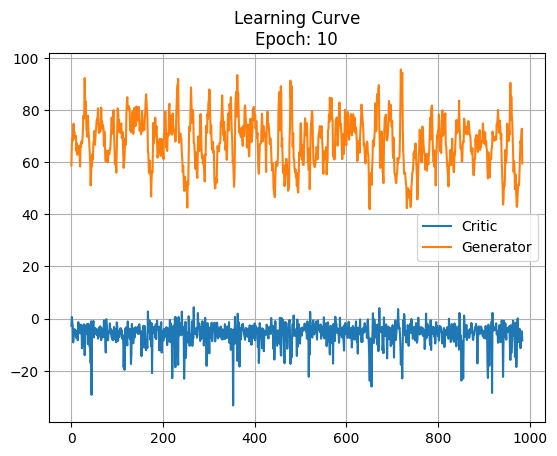

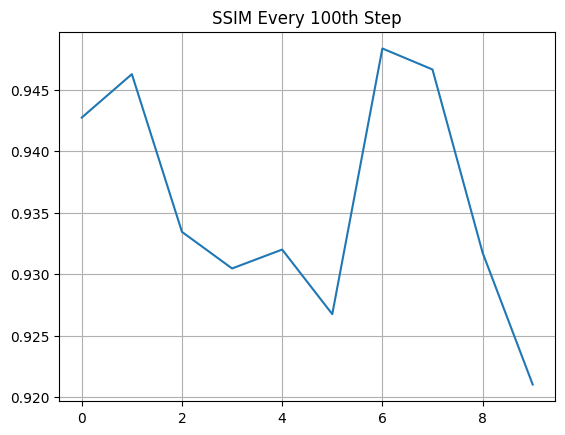

  0%|          | 0/985 [00:00<?, ?it/s]

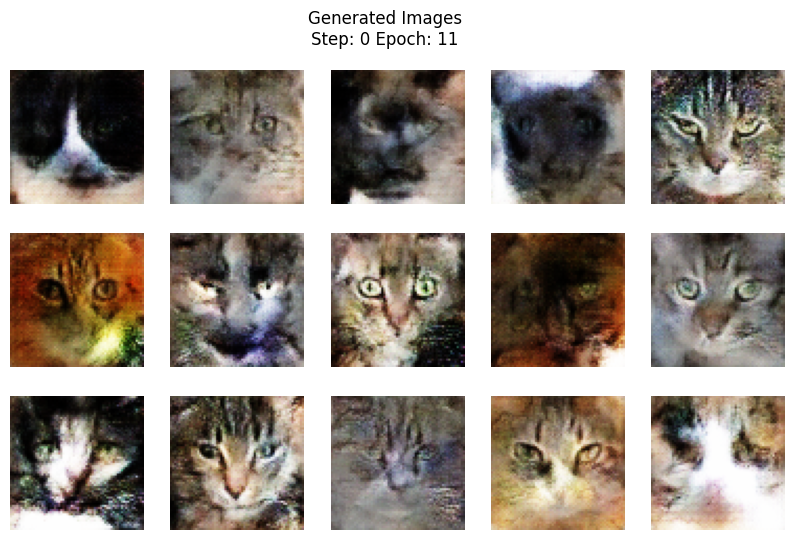

 51%|█████     | 500/985 [01:20<01:17,  6.30it/s]

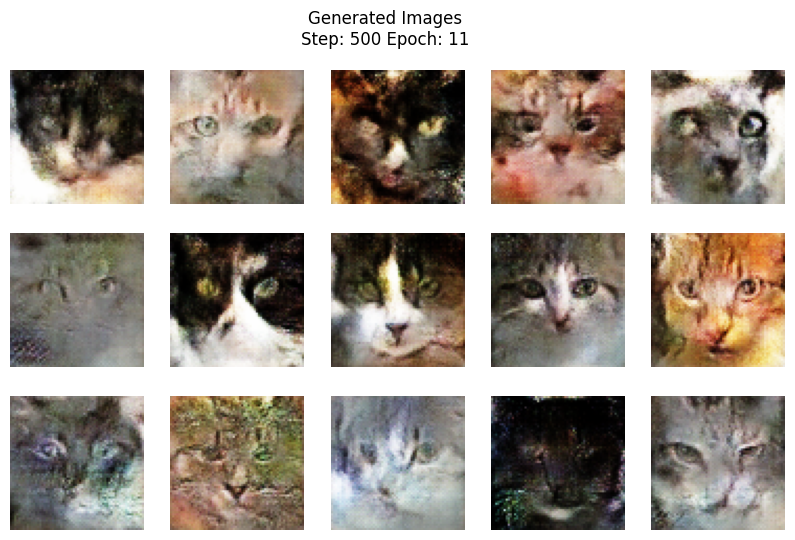

100%|██████████| 985/985 [02:38<00:00,  6.22it/s]


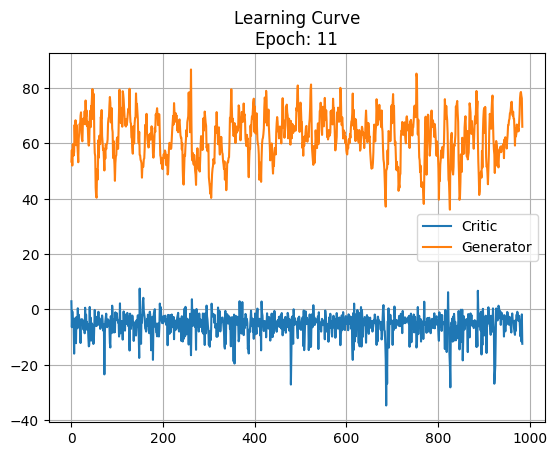

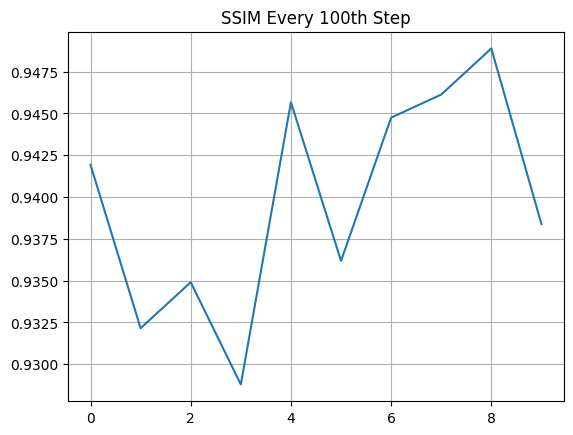

  0%|          | 0/985 [00:00<?, ?it/s]

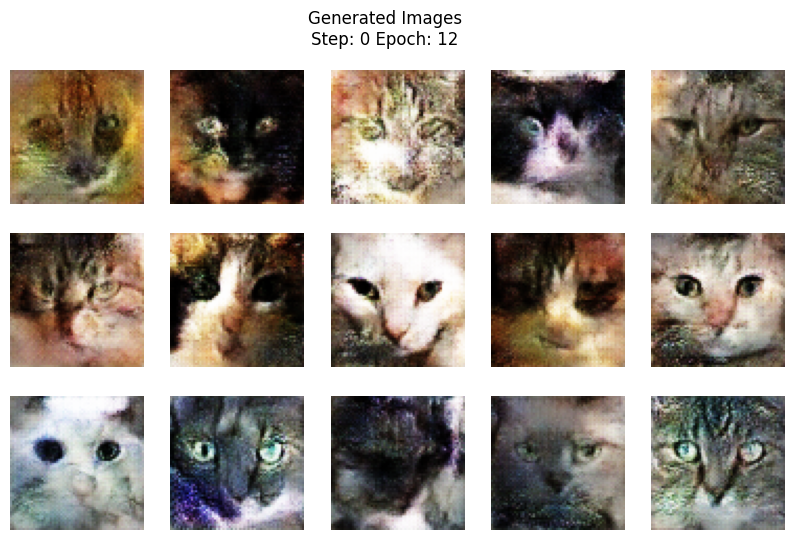

 51%|█████     | 500/985 [01:20<01:16,  6.31it/s]

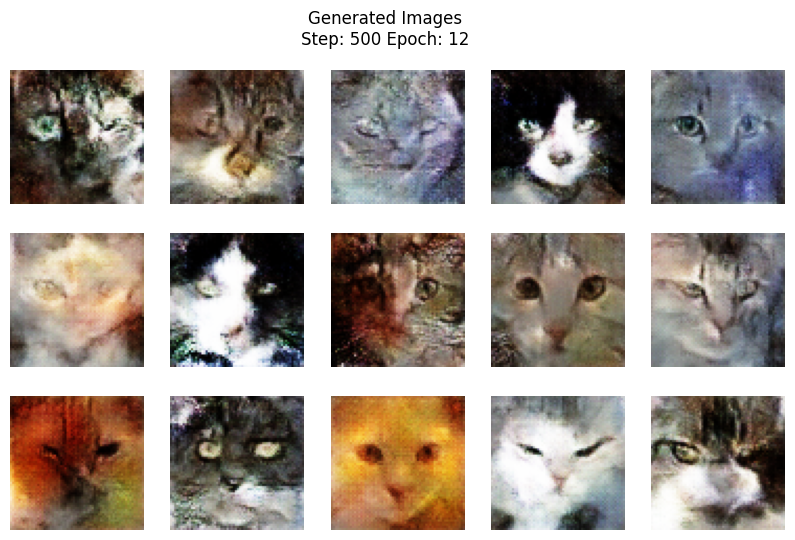

100%|██████████| 985/985 [02:38<00:00,  6.20it/s]


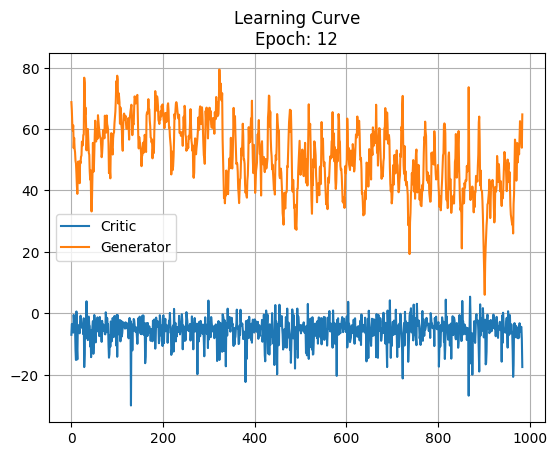

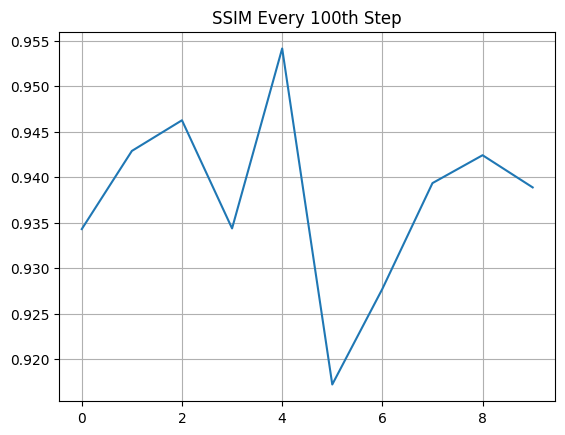

  0%|          | 0/985 [00:00<?, ?it/s]

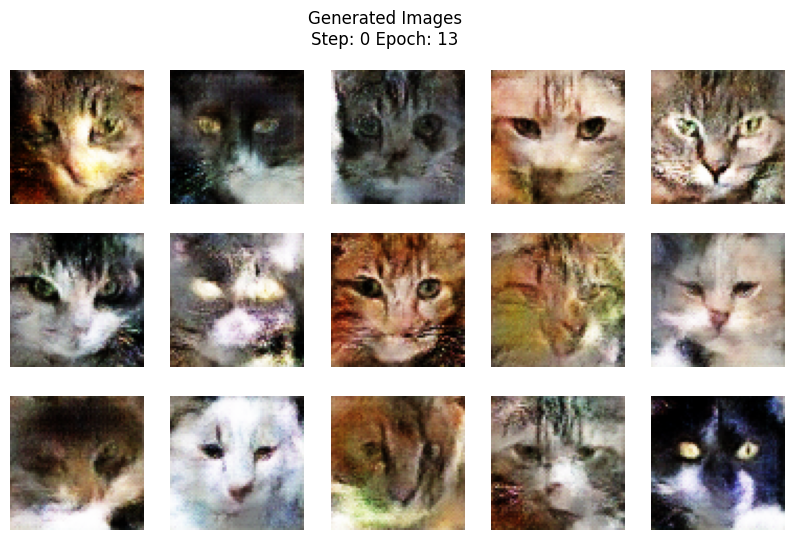

 51%|█████     | 500/985 [01:20<01:17,  6.30it/s]

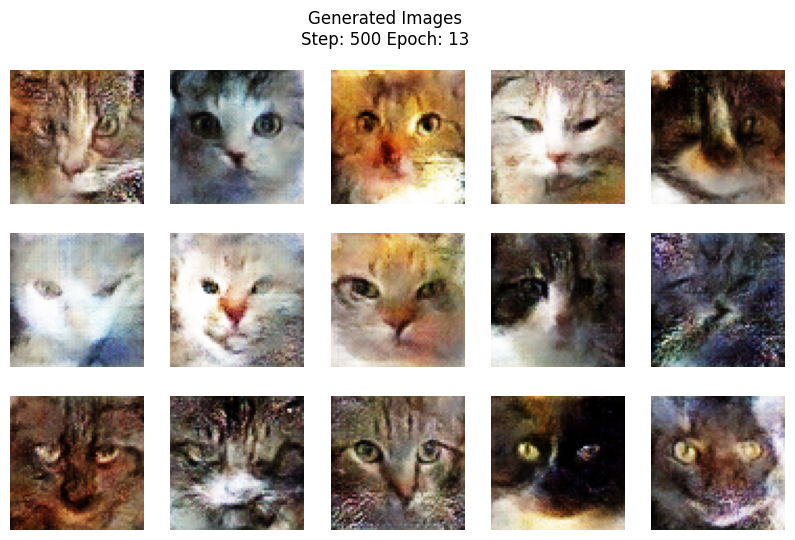

100%|██████████| 985/985 [02:38<00:00,  6.22it/s]


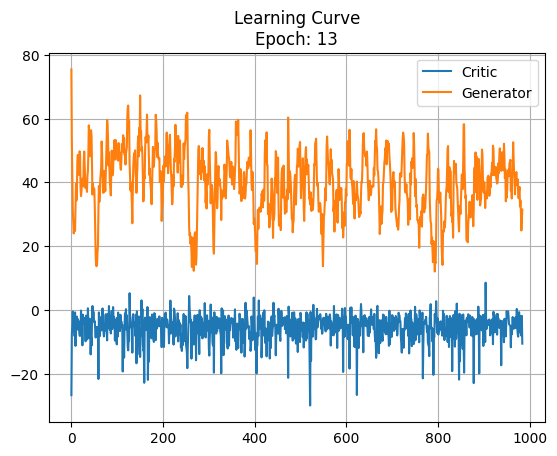

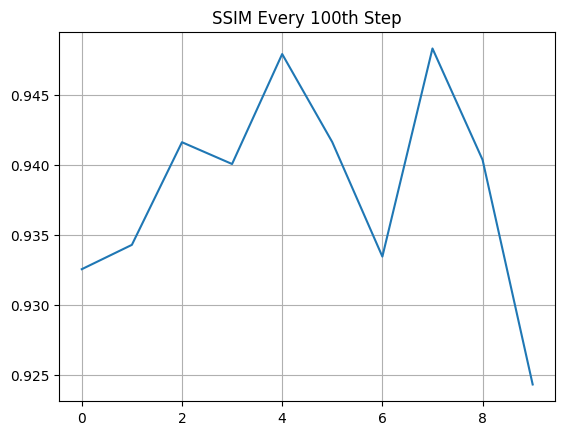

  0%|          | 0/985 [00:00<?, ?it/s]

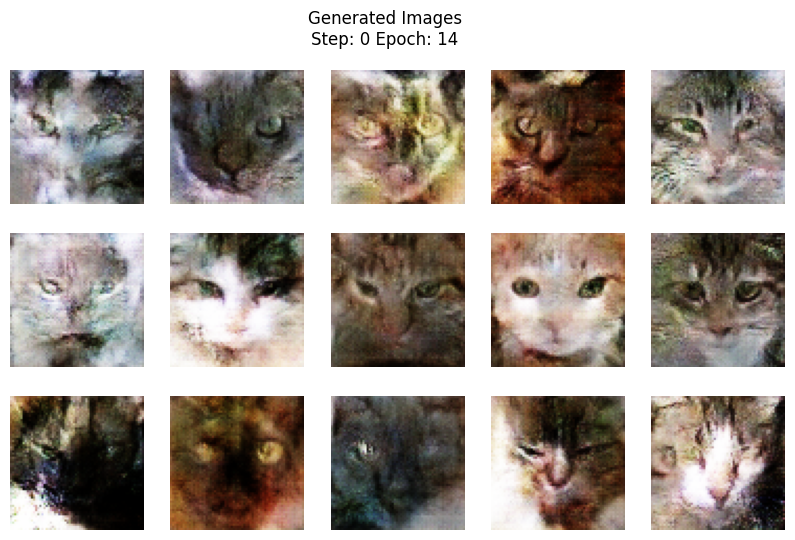

 51%|█████     | 500/985 [01:20<01:16,  6.31it/s]

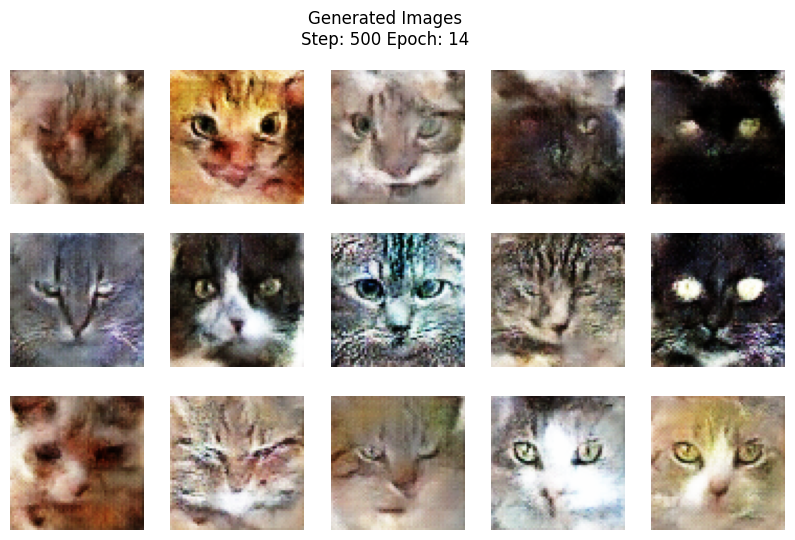

100%|██████████| 985/985 [02:38<00:00,  6.21it/s]


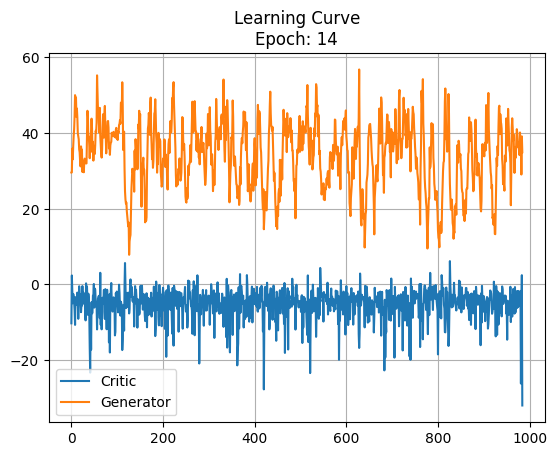

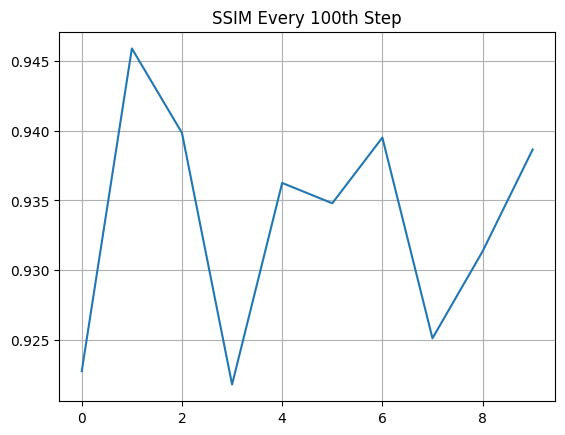

  0%|          | 0/985 [00:00<?, ?it/s]

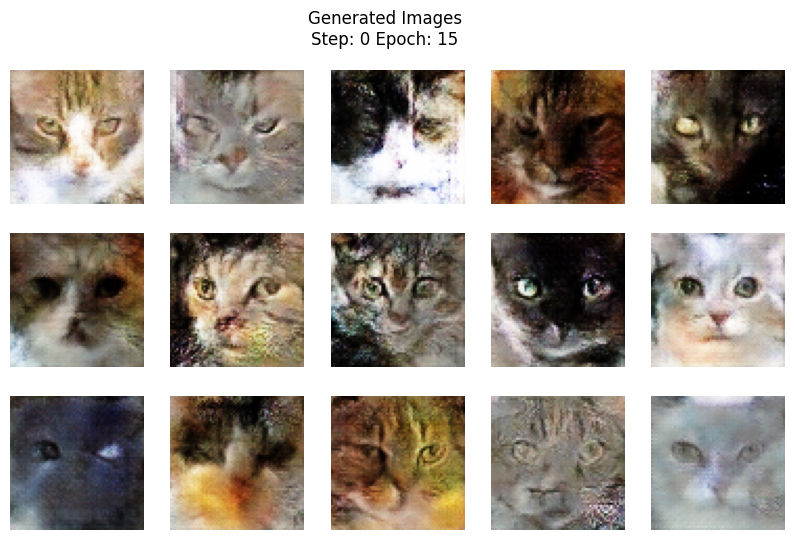

 51%|█████     | 500/985 [01:20<01:16,  6.30it/s]

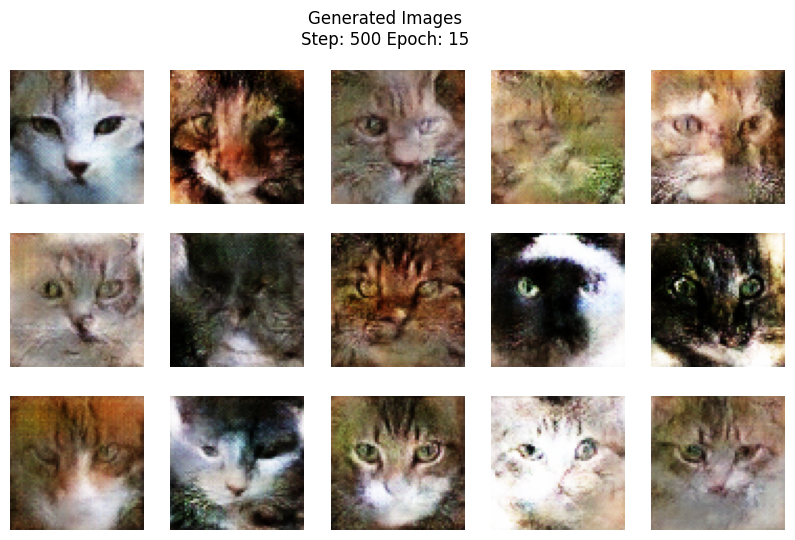

100%|██████████| 985/985 [02:38<00:00,  6.21it/s]


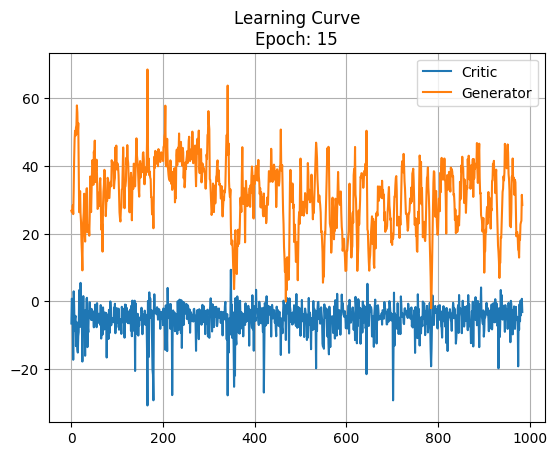

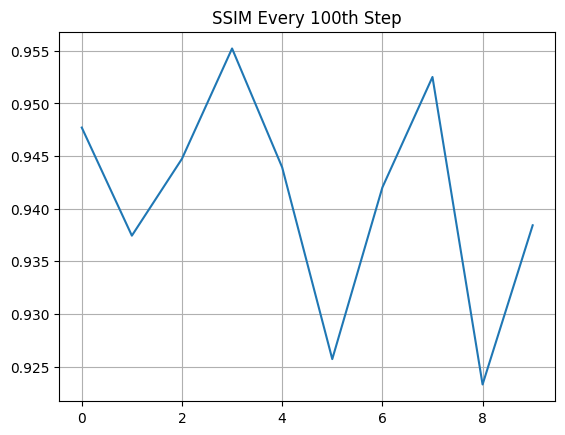

In [42]:
# Save Learning Curves
dir = './GANLearningCurve'
if not os.path.exists(dir):
    os.mkdir(dir)


# Start the training process
for epoch in range(1, EPOCHS+ 1):

    # Record Losses
    CRITIC_LOSSES = []
    GENERATOR_LOSSES = []
    SSIM_SCORES = []

    # Load the data.
    step = 0
    for real, _ in tqdm(dataloader):

        # Current step configurations
        curr_batch_size = len(real)
        real_images = real.to(DEVICE)

        mean_iter_critic_loss = 0

        for _ in range(CRITIC_STEPS):

            # Updating the critic
            critic_optim.zero_grad()

            fake_images = generator(generate_noise(curr_batch_size))
            critic_fake_preds = critic(fake_images.detach())
            critic_real_preds = critic(real_images)

            epsilon = torch.rand(curr_batch_size, 1, 1, 1, device=DEVICE, requires_grad=True)
            gp = gradient_penalty(extract_gradients(critic, real_images, fake_images.detach(), epsilon))

            critic_loss = compute_critic_loss(critic_fake_preds, critic_real_preds, gp, C_LAMBDA)

            mean_iter_critic_loss += critic_loss.item() / CRITIC_STEPS

            critic_loss.backward(retain_graph=True)
            critic_optim.step()

        CRITIC_LOSSES += [mean_iter_critic_loss]

        # Update the generator
        generator_optim.zero_grad()
        fake_images = generator(generate_noise(curr_batch_size))
        critic_fake_pred = critic(fake_images)

        generator_loss = compute_generator_loss(critic_fake_pred)
        generator_loss.backward()
        generator_optim.step()

        GENERATOR_LOSSES += [generator_loss.item()]

        if (step % 100 == 0):
            score = ssim(real_images.detach(), fake_images.detach())
            SSIM_SCORES.append(score.detach().cpu())

        if (step % DISPLAY_STEP == 0):

            noise = generate_noise(15)
            synthetic_images = generator(noise)

            show_generations(
                synthetic_images,
                rows_cols=(3, 5), figsize=(10, 6),
                title=f"Generated Images\nStep: {step} Epoch: {epoch}",
                save_loc = f"./GeneratorImages/Epoch_{epoch}/synthetic_image_{step}.png"
            )

        step += 1

    # Render Learning curve after every epoch
    plt.title(f"Learning Curve\nEpoch: {epoch}")
    plt.plot(CRITIC_LOSSES, label='Critic')
    plt.plot(GENERATOR_LOSSES, label='Generator')
    plt.grid()
    plt.legend()
    plt.savefig(f"./{dir}/LC_Epoch{epoch}.png")
    plt.show()

    plt.title("SSIM Every 100th Step")
    plt.plot(SSIM_SCORES)
    plt.grid()
    plt.savefig(f"./{dir}/SSIM_Score_{epoch}.png")
    plt.show()

Потери критика стабилизировались уже к 250-й итерации первой эпохи обучения. Loss генератора за 15 эпох совершил существенное падение, однако к концу довольно сильно осцилирует.

In [30]:
from IPython.display import Image

Изображения, сгенерированные в процессе обучения, можно склеить в гифку для наглядной демонстрации прогресса. Впрочем, примерно в последние ~5 эпох прогресс не совсем очевиден.

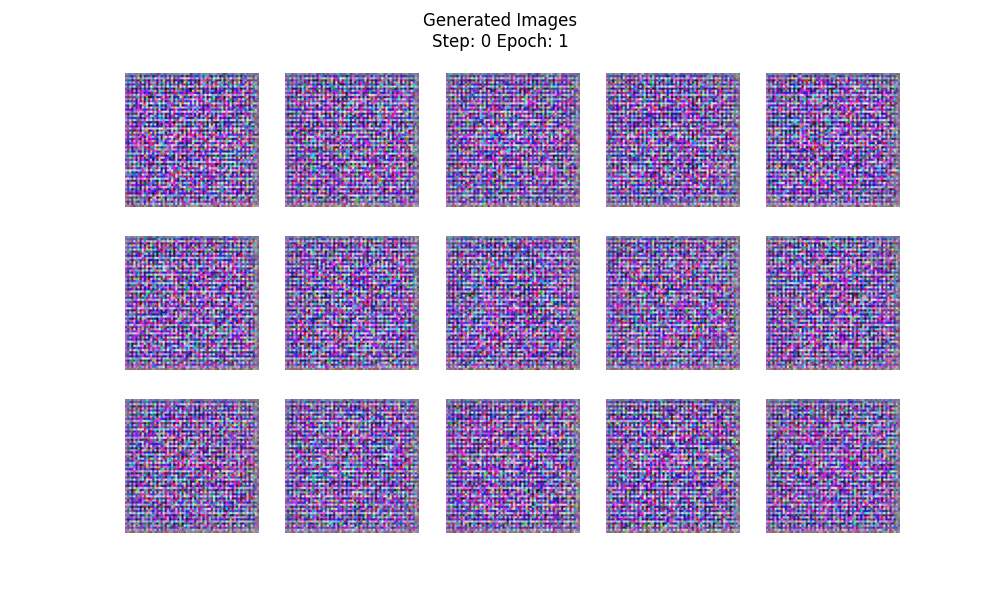

In [35]:
Image("wgan_generated_images/TrainingGIF.gif")

## **Финальные генерации модели**

На этом этапе наш WGAN обучен и теперь готов генерировать реалистичные синтетические изображения.

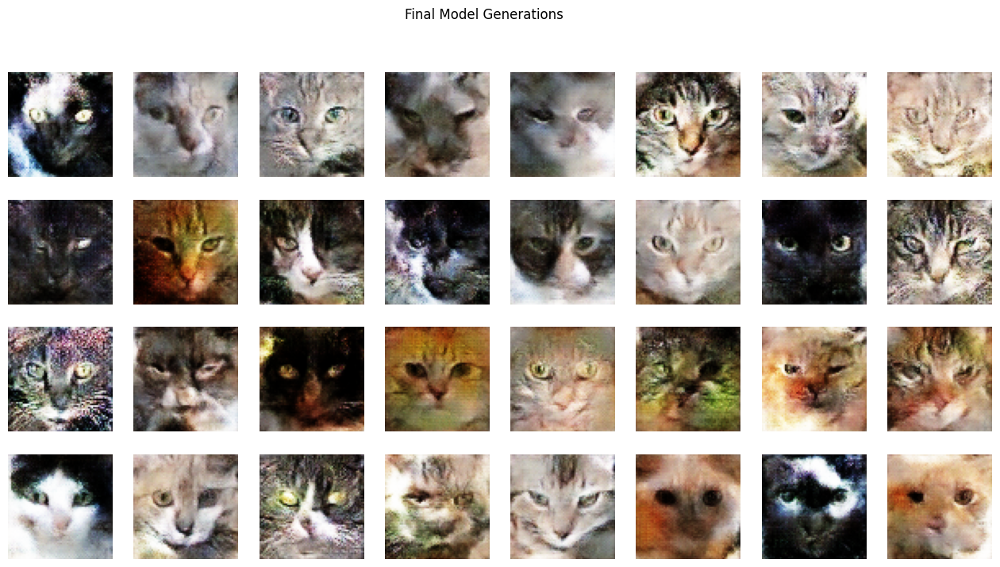

In [43]:
# Generate Images
noise = generate_noise(32)
syn_images = generator(noise)

# Show Generated Images
show_generations(
    syn_images, rows_cols=(4, 8),
    figsize=(16, 8),
    title="Final Model Generations",
    save_loc = "./FinalGenerations.png"
)

Среди удачных генераций все же попадаются и страшненькие. Видимо, общие характеристики модели остаются на низком уровне.

Основная причина кроется, вероятно, в нестабильности во время обучения.

## **Оценка сходства SSIM**

In [44]:
ssim_scores = []
for batch in range(10):
    # Generate Images
    real_images, _ = next(iter(dataloader))
    noise = generate_noise(len(real_images))
    syn_images = generator(noise).detach().cpu()

    # Compute Similarity score
    score = ssim(real_images, syn_images)
    print(f"Batch : {batch+1:2} Similarity Score: {score}")

    ssim_scores.append(score)

print(f"Mean SSIM Score: {np.mean(ssim_scores)}")

Batch :  1 Similarity Score: 0.9396973252296448
Batch :  2 Similarity Score: 0.9466114044189453
Batch :  3 Similarity Score: 0.9446351528167725
Batch :  4 Similarity Score: 0.9426413178443909
Batch :  5 Similarity Score: 0.9237227439880371
Batch :  6 Similarity Score: 0.9369497299194336
Batch :  7 Similarity Score: 0.9246490001678467
Batch :  8 Similarity Score: 0.9404096603393555
Batch :  9 Similarity Score: 0.9280936121940613
Batch : 10 Similarity Score: 0.9381086230278015
Mean SSIM Score: 0.9365518689155579


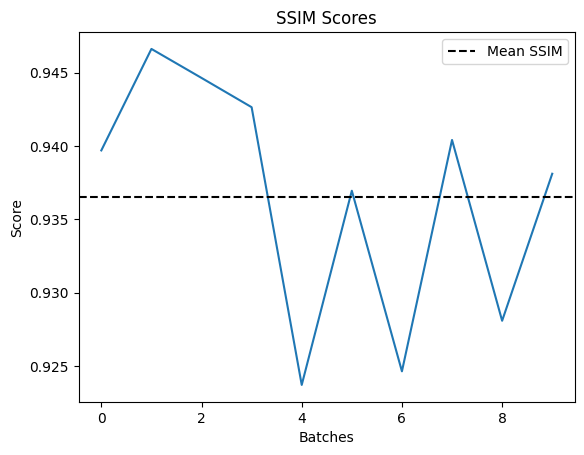

In [45]:
plt.title("SSIM Scores")
plt.plot(ssim_scores)
plt.axhline(np.mean(ssim_scores), linestyle="--", label="Mean SSIM", color='black')
plt.xlabel("Batches")
plt.ylabel("Score")
plt.legend()
plt.show()

Оценка колеблется в районе 0.935, что можно интерпретировать как общую адекватность, присутствие незначительных различий.